## Backtesting Bitcoin with Pandas and Market Data API
### https://alpaca.markets/learn/backtesting-bitcoin-with-pandas-and-market-data-api/

In [479]:
# Initial imports
import os
import requests
import pandas as pd
from dotenv import load_dotenv
import alpaca_trade_api as tradeapi

%matplotlib inline

In [480]:
# Alpaca for data
import alpaca_trade_api as api
from alpaca_trade_api.rest import TimeFrame

# pandas for analysis
import pandas as pd

# Plotly for charting
import plotly.graph_objects as go
import plotly.express as px

# Set default charting for pandas to plotly
pd.options.plotting.backend = "plotly"

### Setting the Backtest Configurations

In [481]:
# symbols we will be looking at
eth = "ETHUSD"
spy = "SPY"

# start dates and end dates for backtest
start_date = "2017-01-01"
end_date = "2022-10-20"

# time frame for backtests
timeframe = TimeFrame.Hour

In [482]:
# periods for our SMA's
fast_SMA = 5
slow_SMA = 13

## Accessing Alpaca Market Data

In [483]:
# Load .env environment variables
load_dotenv()

# Set Alpaca API key and secret
API_KEY = os.getenv("ALPACA_API_KEY")
API_SECRET = os.getenv("ALPACA_SECRET_KEY")

In [484]:
# Setup instance of alpaca api
alpaca = api.REST(API_KEY, API_SECRET)

# # # Request historical bar data for SPY and eth using Alpaca Data API
# for equities, use .get_bars
spy_data = alpaca.get_bars(spy, timeframe, start_date, end_date).df

# for crypto, use .get_crypto_bars, from multiple exchanges
eth_data = alpaca.get_crypto_bars(eth, timeframe, start_date, end_date).df

# display crypto bar data
eth_data

,exchange,open,high,low,close,volume,trade_count,vwap
timestamp,,,,,,,,
2017-01-01 06:00:00+00:00,CBSE,8.38,8.49,8.36,8.49,510.826343,118,8.419156
2017-01-01 07:00:00+00:00,CBSE,8.46,8.49,8.39,8.41,998.368216,96,8.438007
2017-01-01 08:00:00+00:00,CBSE,8.43,8.44,8.35,8.41,423.255450,91,8.376984
2017-01-01 09:00:00+00:00,CBSE,8.41,8.43,8.35,8.38,407.330325,75,8.401902
2017-01-01 10:00:00+00:00,CBSE,8.39,8.42,8.16,8.20,3250.807595,256,8.279448
...,...,...,...,...,...,...,...,...
2022-10-21 03:00:00+00:00,ERSX,1290.33,1291.39,1287.41,1287.41,67.390000,16,1289.326799
2022-10-21 03:00:00+00:00,FTXU,1289.90,1292.30,1287.00,1287.50,91.372000,408,1289.932666
2022-10-21 04:00:00+00:00,CBSE,1287.44,1290.35,1284.66,1288.05,5437.797697,8983,1287.685462


In [485]:
## REMOVING THE HOUR AND MINUTES part 
df = eth_data.copy()
df.index = pd.to_datetime(df.index)

df.index.dtype

# df.index = df.index.normalize()
df.index = df.index.date

In [486]:
df

,exchange,open,high,low,close,volume,trade_count,vwap
2017-01-01,CBSE,8.38,8.49,8.36,8.49,510.826343,118,8.419156
2017-01-01,CBSE,8.46,8.49,8.39,8.41,998.368216,96,8.438007
2017-01-01,CBSE,8.43,8.44,8.35,8.41,423.255450,91,8.376984
2017-01-01,CBSE,8.41,8.43,8.35,8.38,407.330325,75,8.401902
2017-01-01,CBSE,8.39,8.42,8.16,8.20,3250.807595,256,8.279448
...,...,...,...,...,...,...,...,...
2022-10-21,ERSX,1290.33,1291.39,1287.41,1287.41,67.390000,16,1289.326799
2022-10-21,FTXU,1289.90,1292.30,1287.00,1287.50,91.372000,408,1289.932666
2022-10-21,CBSE,1287.44,1290.35,1284.66,1288.05,5437.797697,8983,1287.685462
2022-10-21,ERSX,1287.09,1288.17,1285.81,1286.71,80.890000,14,1286.806665


## ETH vs SPY
### Cleaning and Organizing Our Market Data

In [487]:
# Keep data from only CBSE exchange
eth_data = eth_data[eth_data['exchange'] == 'CBSE'] 

# keep only the daily close data column
eth_data = eth_data.filter(['close'])

# rename our close column to eth
eth_data.rename(columns={'close':'eth'}, inplace=True)

# keep only the date part of our timestamp index
#eth_data.index = eth_data.index.map(lambda timestamp : timestamp.date)

# Clean SPY data
spy_data = spy_data.filter(['close'])
spy_data.rename(columns={'close':'SPY'}, inplace=True)
#spy_data.index = spy_data.index.map(lambda timestamp : timestamp.date)

In [488]:
data = eth_data.join(spy_data, how='outer')
data.index.name = 'date'
data = data.ffill()

### Plot ETH vs SPY 

In [489]:
# calculate data returns for eth and SPY
data['SPY_daily_return'] = data['SPY'].pct_change()
data['eth_daily_return'] = data['eth'].pct_change()

data['SPY_return'] = data['SPY_daily_return'].add(1).cumprod().sub(1)
data['eth_return'] = data['eth_daily_return'].add(1).cumprod().sub(1)

px.line(data,x=data.index, y=['SPY_return', 'eth_return'])

## Computing Simple Moving Average Crossovers

# Computing the 5-day SMA and 13-day SMA
data['slow_SMA'] = data['eth'].rolling(slow_period).mean()
data['fast_SMA'] = data['eth'].rolling(fast_period).mean()

data.dropna(inplace=True)

data.plot(y=['eth', 'slow_SMA', 'fast_SMA'])

In [490]:
# Computing the 5-day SMA and 13-day SMA
data['slow_SMA'] = data['eth'].rolling(slow_SMA).mean()
data['fast_SMA'] = data['eth'].rolling(fast_SMA).mean()

data.dropna(inplace=True)

data.plot(y=['eth', 'slow_SMA', 'fast_SMA'])

## Calculating SMA Crossovers

In [491]:
# calculating when 5-day SMA crosses over 13-day SMA
crossover = data[(data['fast_SMA'] > data['slow_SMA']) \
       & (data['fast_SMA'].shift() < data['slow_SMA'].shift())]
                     
# calculating when 5-day SMA crosses unsw 13-day SMA
crossunder = data[(data['fast_SMA'] < data['slow_SMA']) \
        & (data['fast_SMA'].shift() > data['slow_SMA'].shift())]

In [492]:
# Plot green upward facing triangles at crossovers
fig1 = px.scatter(crossover, x=crossover.index, y='slow_SMA', \
                  color_discrete_sequence=['green'], symbol_sequence=[49])

# Plot red downward facing triangles at crossunders
fig2 = px.scatter(crossunder, x=crossunder.index, y='fast_SMA', \
                  color_discrete_sequence=['red'], symbol_sequence=[50])

# Plot slow sma, fast sma and price
fig3 = data.plot(y=['eth', 'fast_SMA', 'slow_SMA'])

fig4 = go.Figure(data=fig1.data + fig2.data + fig3.data)
fig4.update_traces(marker={'size': 13})
fig4.show()

In [493]:
# New column for orders
crossover['order'] = 'buy'
crossunder['order'] = 'sell'


# Combine buys and sells into 1 data frame
orders = pd.concat([crossover[['eth', 'order']], crossunder[['eth','order']]]).sort_index()

# new dataframe with market data and orders merged
portfolio = pd.merge(data, orders, how='outer', left_index=True, right_index=True)

/Users/adriencaudron/miniforge3/envs/dev/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/Users/adriencaudron/miniforge3/envs/dev/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



## Computing The Backtest

In [494]:
# "backtest" of our buy and hold strategies
portfolio['SPY_buy_&_hold'] = (portfolio['SPY_return'] + 1) * 10000
portfolio['eth_buy_&_hold'] = (portfolio['eth_return'] + 1) * 10000

In [495]:
# forward fill any missing data points in our buy & hold strategies 
# and forward fill eth_daily_return for missing data points
portfolio[['eth_buy_&_hold', 'SPY_buy_&_hold', 'eth_daily_return',]] = \
                    portfolio[['eth_buy_&_hold', 'SPY_buy_&_hold', 'eth_daily_return']].ffill()

In [496]:
### Backtest of SMA crossover strategy
active_position = False
equity = 10000
fee = 0.00055

# Iterate row by row of our historical data
for index, row in portfolio.iterrows():
    
    # change state of position
    if row['order'] == 'buy':
        active_position = True
    elif row['order'] == 'sell':
        active_position = False
    
    # update strategy equity
    if active_position:
        portfolio.loc[index, 'signal'] = 1
        portfolio.loc[index, 'eth_SMA_crossover'] = (row['eth_daily_return'] + 1) * equity *(1-fee)
        equity = portfolio.loc[index, 'eth_SMA_crossover']
    else:
        portfolio.loc[index, 'eth_SMA_crossover'] = equity
        portfolio.loc[index, 'signal'] = 0

In [497]:
fig=px.line(portfolio[['eth_SMA_crossover', 'eth_buy_&_hold',  'SPY_buy_&_hold']], color_discrete_sequence=['green','blue', 'red'])

fig.show()

In [498]:
portfolio

,eth_x,SPY,SPY_daily_return,eth_daily_return,SPY_return,eth_return,slow_SMA,fast_SMA,eth_y,order,SPY_buy_&_hold,eth_buy_&_hold,eth_SMA_crossover,signal
date,,,,,,,,,,,,,,
2017-01-03 10:00:00+00:00,8.53,224.93,0.000311,0.002350,0.000311,0.004711,8.408462,8.486,NaN,NaN,10003.113048,1.004711e+04,1.000000e+04,0.0
2017-01-03 11:00:00+00:00,8.57,225.26,0.001467,0.004689,0.001779,0.009423,8.423077,8.518,NaN,NaN,10017.788846,1.009423e+04,1.000000e+04,0.0
2017-01-03 12:00:00+00:00,8.56,225.16,-0.000444,-0.001167,0.001334,0.008245,8.436923,8.528,NaN,NaN,10013.341635,1.008245e+04,1.000000e+04,0.0
2017-01-03 13:00:00+00:00,8.61,225.00,-0.000711,0.005841,0.000623,0.014134,8.455385,8.556,NaN,NaN,10006.226096,1.014134e+04,1.000000e+04,0.0
2017-01-03 14:00:00+00:00,8.84,225.00,0.000000,0.026713,0.000623,0.041225,8.496923,8.622,NaN,NaN,10006.226096,1.041225e+04,1.000000e+04,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-10-21 00:00:00+00:00,1284.57,364.13,0.000000,0.001544,0.619363,150.303887,1289.323077,1283.336,NaN,NaN,16193.631593,1.513039e+06,4.014922e+08,0.0
2022-10-21 01:00:00+00:00,1286.32,364.13,0.000000,0.001362,0.619363,150.510012,1288.866923,1284.154,NaN,NaN,16193.631593,1.515100e+06,4.014922e+08,0.0
2022-10-21 02:00:00+00:00,1289.89,364.13,0.000000,0.002775,0.619363,150.930506,1288.255385,1285.220,NaN,NaN,16193.631593,1.519305e+06,4.014922e+08,0.0


## Calculating The Sharpe Ratio

In [499]:
portfolio['eth_SMA_daily_returns'] = portfolio['eth_SMA_crossover'].pct_change()

mean_daily_return = portfolio['eth_SMA_daily_returns'].mean()
std_daily_return = portfolio['eth_SMA_daily_returns'].std()
spy_mean_daily_return = portfolio['SPY_daily_return'].mean()

trading_days = 252

daily_sharpe_ratio = (mean_daily_return - spy_mean_daily_return) / std_daily_return

annualized_sharpe_ratio = daily_sharpe_ratio * (trading_days ** 0.5)
annualized_sharpe_ratio

0.4683238511875618

In [500]:
portfolio

,eth_x,SPY,SPY_daily_return,eth_daily_return,SPY_return,eth_return,slow_SMA,fast_SMA,eth_y,order,SPY_buy_&_hold,eth_buy_&_hold,eth_SMA_crossover,signal,eth_SMA_daily_returns
date,,,,,,,,,,,,,,,
2017-01-03 10:00:00+00:00,8.53,224.93,0.000311,0.002350,0.000311,0.004711,8.408462,8.486,NaN,NaN,10003.113048,1.004711e+04,1.000000e+04,0.0,NaN
2017-01-03 11:00:00+00:00,8.57,225.26,0.001467,0.004689,0.001779,0.009423,8.423077,8.518,NaN,NaN,10017.788846,1.009423e+04,1.000000e+04,0.0,0.000000
2017-01-03 12:00:00+00:00,8.56,225.16,-0.000444,-0.001167,0.001334,0.008245,8.436923,8.528,NaN,NaN,10013.341635,1.008245e+04,1.000000e+04,0.0,0.000000
2017-01-03 13:00:00+00:00,8.61,225.00,-0.000711,0.005841,0.000623,0.014134,8.455385,8.556,NaN,NaN,10006.226096,1.014134e+04,1.000000e+04,0.0,0.000000
2017-01-03 14:00:00+00:00,8.84,225.00,0.000000,0.026713,0.000623,0.041225,8.496923,8.622,NaN,NaN,10006.226096,1.041225e+04,1.000000e+04,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-10-21 00:00:00+00:00,1284.57,364.13,0.000000,0.001544,0.619363,150.303887,1289.323077,1283.336,NaN,NaN,16193.631593,1.513039e+06,4.014922e+08,0.0,0.000000
2022-10-21 01:00:00+00:00,1286.32,364.13,0.000000,0.001362,0.619363,150.510012,1288.866923,1284.154,NaN,NaN,16193.631593,1.515100e+06,4.014922e+08,0.0,0.000000
2022-10-21 02:00:00+00:00,1289.89,364.13,0.000000,0.002775,0.619363,150.930506,1288.255385,1285.220,NaN,NaN,16193.631593,1.519305e+06,4.014922e+08,0.0,0.000000


# Calculating Daily Returns for Backstesting

In [501]:
daily_returns = portfolio['eth_SMA_daily_returns']

In [502]:
# Plot the daily returns of the S&P 500 over the last 5 years
daily_returns.plot()

### Calculate Cumulative Returns

In [503]:
# Calculate the cumulative returns using the 'cumprod()' function
cumulative_returns = (1 + daily_returns).cumprod()
cumulative_returns.head()

date
2017-01-03 10:00:00+00:00    NaN
2017-01-03 11:00:00+00:00    1.0
2017-01-03 12:00:00+00:00    1.0
2017-01-03 13:00:00+00:00    1.0
2017-01-03 14:00:00+00:00    1.0
Name: eth_SMA_daily_returns, dtype: float64

### Plot Cumulative Returns

In [504]:
# Plot the daily returns of the S&P 500 over the last 5 years
cumulative_returns.plot()

## Export Portfolio to .CSV

In [515]:
##### Transform Portfolio df
output = portfolio [['eth_x','signal']].rename(columns={'eth_x': 'eth'})

In [517]:
output.head()

,eth,signal
date,,
2017-01-03 10:00:00+00:00,8.53,0.0
2017-01-03 11:00:00+00:00,8.57,0.0
2017-01-03 12:00:00+00:00,8.56,0.0
2017-01-03 13:00:00+00:00,8.61,0.0
2017-01-03 14:00:00+00:00,8.84,0.0


In [518]:
output.to_csv("Auto_Label_ETH_jan17-oct2022.csv")

## Testing QuantStats

In [519]:
import quantstats as qs
# fetch the daily returns for a output
stock = qs.utils.to_returns(output.eth)

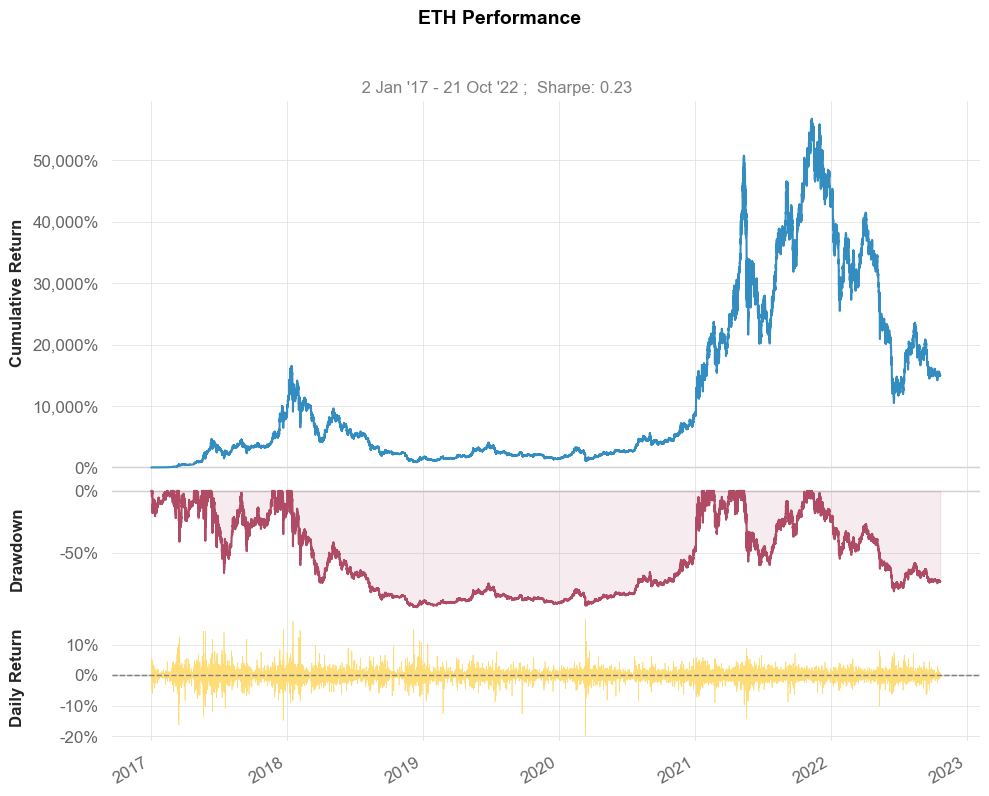

In [520]:
qs.plots.snapshot(stock, title='ETH Performance')